# Imports

In [2]:
import os
import pickle
import pandas as pd
import numpy as np
import glob
from sklearn.cluster import MiniBatchKMeans, KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import pairwise_distances

import matplotlib.pyplot as plt
from tqdm.notebook import tqdm  # Use the notebook-friendly version

# !pip install plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
pio.renderers.default = 'notebook'  # or 'inline' or 'iframe' depending on environment

import IPython
import torch
from speechbrain.dataio.dataio import read_audio, write_audio
from loquacious_set_prepare_filter import load_datasets

seed = 10
np.random.seed(seed)



# Loq small

In [1]:
mfcc_sm_path = "/local_disk/apollon/rwhetten/sss_data_selection/save/loq/mel_small_ckpt.pkl"
speaker_sm_path = "/local_disk/apollon/rwhetten/sss_data_selection/save/loq/speaker_small_ckpt.pkl"
sense_sm_path = "/local_disk/apollon/rwhetten/sss_data_selection/save/loq/sense_small_features"
csv_location = "/local_disk/apollon/rwhetten/loquacious_small_train.csv"
save_folder = "/local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/loq_sm"
fractions = [0.2, 0.4, 0.5, 0.6, 0.8]



In [3]:
# create save_folder
if not os.path.exists(save_folder):
    os.makedirs(save_folder)
    print(f"Folder '{save_folder}' created.")
else:
    print(f"Folder '{save_folder}' already exists.")

Folder '/local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/loq_sm' already exists.


## Utility function for running K-Means and sampling based on K-Means

In [4]:
def run_kmeans(df, k=100, limit=20000, save_img="", feature_name="MFCCs"):
    mb_kmeans = MiniBatchKMeans(n_clusters=k,
                                random_state=42,
                                batch_size=64 * k,
                                init='k-means++', n_init=1, init_size=100000,
                                reassignment_ratio=5e-4,
                                verbose=0)
    
    mb_kmeans.fit(df)
    predictions = mb_kmeans.labels_
    cluster_centers = mb_kmeans.cluster_centers_
    
    ## PCA and visualize
    pca_2d = PCA(n_components=2, random_state=42)
    d_pca_2d = pca_2d.fit_transform(df[:limit])
    cluster_centers_pca_2d = pca_2d.transform(cluster_centers)
    
    plt.figure(figsize=(10, 7))
    # Scatter plot of PCA-reduced data points, colored by their assigned cluster
    scatter_2d = plt.scatter(d_pca_2d[:, 0], d_pca_2d[:, 1], c=predictions[:limit], cmap='viridis', s=50, alpha=0.7)
    # Plot the PCA-reduced cluster centers
    plt.scatter(cluster_centers_pca_2d[:, 0], cluster_centers_pca_2d[:, 1], marker='X', s=50, color='red',
                edgecolor='black', label='Cluster Centers')
    plt.title(f'K-Means Clustering on {feature_name} (PCA-Reduced to 2D, k={k})')
    plt.xlabel(f'Principal Component 1 (explains {pca_2d.explained_variance_ratio_[0]*100:.2f}%)')
    plt.ylabel(f'Principal Component 2 (explains {pca_2d.explained_variance_ratio_[1]*100:.2f}%)')
    plt.colorbar(scatter_2d, label='Cluster ID')
    plt.legend()
    plt.grid(True)
    plt.savefig(save_img, dpi=300)
    plt.close()
    return predictions

In [5]:
def diverse_sample(cluster_df, frac, random_state=0):
    N = int(len(cluster_df) * frac)
    k = len(cluster_df['cluster'].unique())
    labels = cluster_df['cluster']
    clusters = [np.where(labels == i)[0] for i in range(k)]
    cluster_sizes = [len(c) for c in clusters]

    # Step 1: Allocate at least one per cluster (if cluster is non-empty)
    allocated = [min(1, size) for size in cluster_sizes]
    remaining = N - sum(allocated)

    # Step 2: Distribute remaining not propotionally (capped by cluster size)
    total_remaining_capacity = sum(max(size - alloc, 0) for alloc, size in zip(allocated, cluster_sizes))
    i = 1
    done = False
    while not done:
        for i in range(k):
            cap = max(cluster_sizes[i] - allocated[i], 0)
            if cap > 0:
                allocated[i] += 1
                remaining -= 1
            if remaining <= 0:
                done = True
                break

    # Step 3: Sample using furthest-point sampling within each cluster
    sampled_indices = []
    for i, count in enumerate(allocated):
        if count > 0:
            X_cluster = cluster_df[cluster_df.cluster == i]
            to_add = list(X_cluster.sample(n=count, random_state=random_state).ID)
            sampled_indices.extend(to_add)
            
    return sampled_indices

def sample_kmeans_upto(csv_loc, save_loc, fracts, cluster_df, name_beg="mfccs", random_state=0):
    main_df = pd.read_csv(csv_loc)
    hours = []
    for i in fracts:
        ids = diverse_sample(cluster_df, i, random_state)
        # filter with main df and then save
        filtered_main_df = main_df[main_df['ID'].isin(ids)]
        hours.append(filtered_main_df.duration.sum()/ 3600)
        print(f"{len(filtered_main_df)} files and {round((filtered_main_df.duration.sum()/ 3600), 2)} hours")
        save_name = f"{save_loc}/{name_beg}_{str(i)}.csv"
        # print(f"saving to {save_name}")
        filtered_main_df.to_csv(save_name, index=False)
    return hours


In [ ]:
def get_rand_csvs(csv_location, fractions):
    main_df = pd.read_csv(csv_location)
    for fraction in fractions:
        sampled_df = main_df.sample(n=int(len(main_df) * fraction), random_state=0)
        print(f"{sampled_df.duration.sum()/ 3600} hours")
        save_name = f"{save_folder}/random_{str(fraction)}.csv"
        print(f"Saving as {save_name}")
        sampled_df.to_csv(save_name, index=False)

## Random

In [9]:
get_rand_csvs(csv_location, fractions)

49.938754715254156 hours
Saving as /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/loq_sm/random_0.2.csv
100.1914927472482 hours
Saving as /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/loq_sm/random_0.4.csv
124.99946393152402 hours
Saving as /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/loq_sm/random_0.5.csv
150.0147689021361 hours
Saving as /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/loq_sm/random_0.6.csv
199.98969292853604 hours
Saving as /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/loq_sm/random_0.8.csv


## MFCCs

In [11]:
# get df
with open(mfcc_sm_path, "rb") as f:
    mfcc_sm = pickle.load(f)

df = pd.DataFrame.from_dict(mfcc_sm['results']).T
print(len(df))
# df.head()


107303


In [12]:
predictions = run_kmeans(df, k=100, limit=100000, save_img=f"{save_folder}/mfcc_sm.png")

In [13]:
mfcc_clus = pd.DataFrame({
    "ID" : df.index,
    "cluster" : predictions,
})

In [14]:
hours = sample_kmeans_upto(csv_location, save_folder, fractions, mfcc_clus, "mfcc", 42)

21460 files and 49.12 hours
42921 files and 97.99 hours
53651 files and 122.8 hours
64381 files and 147.59 hours
85842 files and 198.0 hours


## Speaker

In [18]:
# get df
with open(speaker_sm_path, "rb") as f:
    speaker_sm = pickle.load(f)

speaker_df = pd.DataFrame.from_dict(speaker_sm['results']).T
print(len(speaker_df))
# speaker_df.tail()


107303


In [19]:
speaker_predictions = run_kmeans(
    speaker_df, 
    k=100, 
    limit=100000, 
    save_img=f"{save_folder}/speaker_sm.png",
    feature_name="Speaker Embeddings"
)

In [20]:
speaker_clus = pd.DataFrame({
    "ID" : df.index,
    "cluster" : speaker_predictions,
})

In [21]:
hours = sample_kmeans_upto(csv_location, save_folder, fractions, speaker_clus, "speaker", 29)

21460 files and 53.75 hours
42921 files and 105.03 hours
53651 files and 130.32 hours
64381 files and 155.2 hours
85842 files and 203.08 hours


## Linguistic Features (Sense)

In [22]:
main_df = pd.read_csv(csv_location)

In [23]:
def load_all_features(save_dir, pattern="features_batch_*.pkl"):
    """Loads and combines all saved feature files into a single dict and array."""
    feature_dict = {}
    feature_list = []
    name_list = []

    file_paths = sorted(glob.glob(os.path.join(save_dir, pattern)))

    for path in file_paths:
        with open(path, "rb") as f:
            batch_data = pickle.load(f)
        feature_dict.update(batch_data)
        name_list.extend(batch_data.keys())
        feature_list.extend(batch_data.values())

    # Convert to arrays for clustering etc.
    features = np.stack(feature_list)
    names = np.array(name_list)

    return feature_dict, features, names

In [24]:
sense_data = load_all_features(sense_sm_path)

In [25]:
sense_data[1].shape

(109065, 1024)

In [26]:
# check that I have all the features
if len(main_df) == sense_data[1].shape[0]:
    print("Good to go")

In [11]:
df = pd.DataFrame(sense_data[1], index=sense_data[2])
print(len(df))
df.head()


263055


,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
14178/12709_14178_000179.wav0.0,0.017819,0.075021,-0.021218,-0.018340,-0.041707,-0.069822,0.030062,0.046402,-0.005984,0.031005,...,-0.019416,0.028961,-0.044426,0.040781,-0.017451,-0.019911,0.019044,-0.031291,0.026437,0.020439
13346/12709_13346_000512.wav0.0,-0.046402,0.054410,-0.007886,-0.017702,-0.018399,-0.018118,0.000446,0.037386,0.043620,-0.023904,...,-0.011088,0.039121,-0.030731,0.042786,-0.053724,-0.014585,0.026632,0.023814,-0.025850,0.010436
8878/10827_8878_000125.wav0.0,-0.030297,0.032447,-0.045153,0.025265,0.005840,-0.022194,-0.004518,0.044706,0.029640,0.006624,...,0.014667,0.041958,-0.071051,0.028847,-0.037667,0.005708,0.029422,-0.028307,0.013764,-0.019048
10625/12899_10625_001780.wav0.0,0.000612,0.068738,-0.063982,0.021254,-0.034654,-0.079818,0.001304,0.017327,-0.004960,0.009991,...,-0.040566,0.010339,-0.005325,0.002957,-0.009964,0.035235,-0.010261,-0.018763,-0.032497,-0.034009
14327/12899_14327_000065.wav0.0,-0.031178,0.035402,-0.022179,0.002484,-0.038883,-0.113693,0.028063,0.021089,0.013532,-0.020023,...,-0.009405,0.006816,-0.080628,0.019156,-0.031484,-0.012756,-0.032253,0.017370,-0.026272,-0.011458


In [12]:
sense_predictions = run_kmeans(
    df, 
    k=100, 
    limit=100000, 
    save_img=f"{save_folder}/sense_sm.png",
    feature_name="SENSE Embeddings"
)

In [13]:
sense_clus = pd.DataFrame({
    "ID" : df.index,
    "cluster" : sense_predictions,
})

In [128]:
hours = sample_based_on_cluster(csv_location, save_folder, fractions, sense_clus, "sense", 29)

samples per cluster 526 and remainder 11
52040 files and 216.27 hours
samples per cluster 1052 and remainder 22
103538 files and 430.27 hours
samples per cluster 1315 and remainder 27
128988 files and 536.53 hours
samples per cluster 1578 and remainder 33
153842 files and 640.24 hours
samples per cluster 2104 and remainder 44
198840 files and 827.52 hours


In [ ]:
# samples per cluster 526 and remainder 11
# 52040 files and 216.27 hours
# samples per cluster 1052 and remainder 22
# 103538 files and 430.27 hours
# samples per cluster 1315 and remainder 27
# 128988 files and 536.53 hours
# samples per cluster 1578 and remainder 33
# 153842 files and 640.24 hours
# samples per cluster 2104 and remainder 44
# 198840 files and 827.52 hours

In [152]:
hours = sample_kmeans_upto(csv_location, save_folder, fractions, sense_clus, "sense_full", 29)

52611 files and 218.69 hours
105222 files and 437.47 hours
131527 files and 547.27 hours
157833 files and 657.02 hours
210444 files and 875.69 hours


# Sample to have similar amount of audio

In [182]:
hours, sdf = sample_based_on_cluster_upto(csv_location, save_folder, [0.5], sense_clus, "sense", 29)

we want 131527 samples
samples per cluster 1315 and remainder 27
128961
remainder = 2566
eligible_clusters len 96
128988 files and 536.53 hours
would be saving to /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/lebench_sm/sense_0.5.csv


In [235]:
diverse_sample(sense_clus, 0.5)

131527
100
remaining 131427
[1, 1571, 1544, 956, 1315, 774, 943, 1539, 1373, 1237, 1009, 1667, 1477, 1131, 1122, 1105, 1232, 919, 1482, 412, 1066, 1255, 1172, 1248, 1241, 597, 1208, 978, 1008, 745, 1073, 891, 1276, 520, 804, 1368, 1491, 566, 901, 1184, 654, 1219, 1333, 1402, 945, 696, 937, 888, 512, 608, 716, 778, 521, 957, 845, 754, 793, 135, 945, 779, 826, 684, 625, 742, 385, 938, 1084, 631, 508, 410, 605, 516, 482, 520, 735, 617, 533, 556, 422, 714, 333, 662, 553, 647, 647, 639, 864, 642, 633, 462, 566, 250, 464, 493, 654, 452, 378, 837, 518, 395]


In [18]:
diverse_sample(df, sense_clus, 0.5)

131527
100
remaining 131427
[1, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 991, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 480, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1342, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1249, 1341, 1341, 1341, 1341, 1341, 1341, 1341, 1341]
[1, 3143, 3125, 1959, 2713, 1613, 1979, 3253, 2940, 2678, 2207, 3678, 3305, 2561, 2566, 2553, 2874, 2166, 3524, 991, 2580, 3067, 2896, 3119, 3140, 1528, 3110, 2547, 2651, 1980, 2874, 2411, 3486, 1439, 2239, 3842, 4250, 1638, 2627, 3486, 1950, 3666, 4066, 4342, 2975, 2217, 3010, 2885, 1682, 2008, 2386, 2614, 1767, 3271, 2926, 2640, 2802, 480, 3385, 2825, 3029, 2536, 2341, 28

In [118]:
ids_to_sample = diverse_sample(df, sense_clus, 0.5)

131527
100
remaining 131427


In [119]:
len(ids_to_sample)

131527

In [73]:
# np.where(sense_clus['cluster'] == 10)
# sense_clus[sense_clus.cluster == 0].index
# df.loc[sense_clus[sense_clus.cluster == 0].ID]

In [278]:
# from sklearn.metrics import pairwise_distances
    
# def furthest_point_sampling(X_cluster, n_samples):
#     """
#     Select n_samples from X_cluster using furthest-point sampling.
#     """
#     if len(X_cluster) <= n_samples:
#         return np.arange(len(X_cluster))  # return all if too small

#     print(f"n_samples {n_samples}")
#     print(f"selected {selected}")
#     distances = pairwise_distances(X_cluster, metric='cosine')
#     selected = [np.random.choice(len(X_cluster))]
#     min_distances = distances[selected[0], :]

#     for _ in range(1, n_samples):
#         min_distances = np.min(distances[:, selected], axis=1)
#         next_index = np.argmax(min_distances)
#         selected.append(next_index)

#     return np.array(selected)

# def diverse_sample(cluster_df, frac):
#     N = int(len(cluster_df) * frac)
#     print(N)
#     k = len(cluster_df['cluster'].unique())
#     print(k)
#     labels = cluster_df['cluster']
#     clusters = [np.where(labels == i)[0] for i in range(k)]
#     cluster_sizes = [len(c) for c in clusters]

#     # Step 1: Allocate at least one per cluster (if cluster is non-empty)
#     allocated = [min(1, size) for size in cluster_sizes]
#     remaining = N - sum(allocated)
#     print(f"remaining {remaining}")

#     # Step 2: Distribute remaining proportionally (capped by cluster size)
#     total_remaining_capacity = sum(max(size - alloc, 0) for alloc, size in zip(allocated, cluster_sizes))
#     i = 1
#     while remaining >= 0:
#         for i in range(k):
#             cap = max(cluster_sizes[i] - allocated[i], 0)
#             if cap > 0:
#                 allocated[i] += 1
#                 remaining -= 1
#             if remaining <= 0:
#                 print(allocated)
#                 print(cluster_sizes)
#                 print(remaining)
#                 return
                
        
#     # for i in range(k):
#     #     # check if done
#     #     if remaining <= 0:
#     #         break
#     #     # skip cluster if already at max size
#     #     cap = max(cluster_sizes[i] - allocated[i], 0)
#     #     if cap == 0:
#     #         continue
        
#     #     add = int(round((cap / total_remaining_capacity) * remaining))
#     #     add = min(add, cap)
#     #     # print(f"add {add}, cap {cap}, remaining {remaining}")
#     #     allocated[i] += add
#     #     remaining -= add
#     print(allocated)
#     print(cluster_sizes)
#     print(remaining)

#     # # Step 3: Sample using furthest-point sampling within each cluster
#     # sampled_indices = []
#     # for i, count in enumerate(allocated):
#     #     if count > 0:
#     #         idxs = clusters[i]
#     #         X_cluster = X[idxs]
#     #         sampled_within = furthest_point_sampling(X_cluster, count)
#     #         sampled_indices.extend(idxs[sampled_within])

#     # return sampled_indices

In [181]:
def sample_based_on_cluster_upto(csv_loc, save_loc, fracts, cluster_df, name_beg="mfccs", random_state=0):
    main_df = pd.read_csv(csv_loc)
    hours = []
    for i in fracts:
        # Assume df is your DataFrame with a 'cluster' column
        X = int(len(main_df) * i)  # total samples you want
        print(f"we want {X} samples")
        clusters = cluster_df['cluster'].unique()
        n_clusters = len(clusters)
        samples_per_cluster = X // n_clusters
        remainder = X % n_clusters

        print(f"samples per cluster {samples_per_cluster} and remainder {remainder}")
        # Group the dataframe by 'cluster'
        grouped = cluster_df.groupby('cluster')
        
        # Sample equally from each cluster
        # if the cluster contains less data than the sample amount 
        # then use all samples from cluster
        sampled_df = grouped.apply(lambda g: g.sample(n=min(len(g), samples_per_cluster), random_state=random_state,), include_groups=False).reset_index(drop=True)
        print(len(sampled_df))
        true_remainder = X - len(sampled_df)
        print(f"remainder = {true_remainder}")
        # If there's a remainder (e.g., 1000 samples over 3 clusters → 333 per cluster + 1 extra),
        # randomly pick clusters to get 1 more sample from

        if true_remainder > 0:
            cluster_sizes = cluster_df['cluster'].value_counts()
            eligible_clusters = cluster_sizes[cluster_sizes > samples_per_cluster].index
            print(f"eligible_clusters len {len(eligible_clusters)}")
            groupby(['cluster']).count()
        if remainder > 0:
            cluster_sizes = cluster_df['cluster'].value_counts()
            eligible_clusters = cluster_sizes[cluster_sizes > samples_per_cluster].index
            extra_clusters = np.random.choice(eligible_clusters, size=min(len(eligible_clusters), remainder), replace=False)
        
            extras = cluster_df[cluster_df['cluster'].isin(extra_clusters)].groupby('cluster').apply(
                lambda g: g.sample(n=1, random_state=random_state), include_groups=False
            ).reset_index(drop=True)
        
            sampled_df = pd.concat([sampled_df, extras], ignore_index=True)
            
        # filter with main df and then save
        filtered_main_df = main_df[main_df['ID'].isin(sampled_df['ID'])]
        hours.append(filtered_main_df.duration.sum()/ 3600)
        print(f"{len(sampled_df)} files and {round((filtered_main_df.duration.sum()/ 3600), 2)} hours")
        save_name = f"{save_loc}/{name_beg}_{str(i)}.csv"
        print(f"would be saving to {save_name}")
        # filtered_main_df.to_csv(save_name, index=False)
    return hours, sampled_df

In [173]:
11//4

2

# Explore SENSE features

In [100]:
df.shape

(263055, 1024)

In [54]:
limit = 100000
k = 100

In [ ]:
mb_kmeans = MiniBatchKMeans(n_clusters=k,
                            random_state=42,
                            batch_size=64 * k,
                            init='k-means++', n_init=1, init_size=100000,
                            reassignment_ratio=5e-4,
                            verbose=0)

mb_kmeans.fit(df)
predictions = mb_kmeans.labels_
cluster_centers = mb_kmeans.cluster_centers_

In [55]:
## PCA and visualize
pca_2d = PCA(n_components=2, random_state=42)
d_pca_2d = pca_2d.fit_transform(df[:limit])
cluster_centers_pca_2d = pca_2d.transform(cluster_centers)

In [56]:
# Build hover info with index
hover_text = [f"Index: {i}" for i in range(limit)]

# Create scatter plot
fig = go.Figure()

# Add data points
fig.add_trace(go.Scatter(
    x=d_pca_2d[:, 0],
    y=d_pca_2d[:, 1],
    mode='markers',
    marker=dict(
        size=6,
        color=predictions[:limit],
        colorscale='Viridis',
        opacity=0.7,
        colorbar=dict(title='Cluster ID')
    ),
    text=hover_text,
    hoverinfo='text',
    name='Data Points'
))

# Add cluster centers
fig.add_trace(go.Scatter(
    x=cluster_centers_pca_2d[:, 0],
    y=cluster_centers_pca_2d[:, 1],
    mode='markers',
    marker=dict(
        size=14,
        symbol='x',
        color='red',
        line=dict(width=2, color='black')
    ),
    name='Cluster Centers'
))

# Layout
fig.update_layout(
    title=f'K-Means Clustering Results on MFCCs (PCA-Reduced to 2D, k={k})',
    xaxis_title=f'Principal Component 1 ({pca_2d.explained_variance_ratio_[0]*100:.2f}%)',
    yaxis_title=f'Principal Component 2 ({pca_2d.explained_variance_ratio_[1]*100:.2f}%)',
    legend=dict(title='Legend'),
    width=900,
    height=700
)

fig.show()

In [57]:
from sklearn.metrics.pairwise import cosine_similarity

In [146]:
test = df[-100:].copy()
test.shape

(100, 1024)

In [147]:
sims = cosine_similarity(test, test)

In [148]:
# Create a copy so we don't modify the original matrix
sims_no_diag = sims.copy()

# Mask the diagonal values (where row index == column index, for overlapping index range)
for i in range(sims.shape[0]):
    if i < sims.shape[1]:  # avoid IndexError when df[:10] vs df[:10000]
        sims_no_diag[i, i] = -np.inf

# Now get the argmax ignoring diagonal
argmax_indices = np.argmax(sims_no_diag, axis=1)

In [149]:
# Get the similarity values at the argmax positions
max_values = sims[np.arange(sims.shape[0]), argmax_indices]

# Optionally, display as a list of tuples: (row_index, best_match_index, similarity)
results = list(zip(np.arange(sims.shape[0]), argmax_indices, max_values))

for row_idx, best_idx, sim_val in results:
    print(f"Row {row_idx} best match is column {best_idx} with similarity {sim_val:.4f}")

Row 0 best match is column 74 with similarity 0.6506
Row 1 best match is column 27 with similarity 0.6248
Row 2 best match is column 29 with similarity 0.6496
Row 3 best match is column 96 with similarity 0.6000
Row 4 best match is column 16 with similarity 0.5413
Row 5 best match is column 99 with similarity 0.6164
Row 6 best match is column 70 with similarity 0.6445
Row 7 best match is column 29 with similarity 0.6686
Row 8 best match is column 15 with similarity 0.6328
Row 9 best match is column 68 with similarity 0.6630
Row 10 best match is column 16 with similarity 0.6560
Row 11 best match is column 62 with similarity 0.6691
Row 12 best match is column 83 with similarity 0.6459
Row 13 best match is column 83 with similarity 0.5927
Row 14 best match is column 61 with similarity 0.6540
Row 15 best match is column 59 with similarity 0.6498
Row 16 best match is column 29 with similarity 0.6699
Row 17 best match is column 12 with similarity 0.5684
Row 18 best match is column 22 with si

In [150]:
argmax_indices

array([74, 27, 29, 96, 16, 99, 70, 29, 15, 68, 16, 62, 83, 83, 61, 59, 29,
       12, 22, 16, 59, 29, 37, 68, 23, 47, 49, 29, 29, 27,  0, 49, 29, 27,
       61, 29, 48, 34, 25, 69, 89, 49, 48, 85, 86, 84, 92, 86, 36, 92, 92,
       65, 75, 26, 27, 22, 23, 74, 17, 20, 68, 34, 11, 23, 99, 51, 11, 50,
       60, 39, 74, 23, 23, 33, 27, 61, 35, 61, 27, 28, 74, 72, 87, 61, 34,
       43, 68, 74, 93, 29, 70, 78, 50, 86, 23, 71, 84, 49, 34, 23])

In [151]:
# main_df[main_df.ID == df.iloc[i].name].wav
main_df[main_df.ID == test.iloc[i].name].wav.iloc[0]
main_df[main_df.ID == test.iloc[i].name].duration.iloc[0]

10.0

In [270]:
main_df[main_df.ID == (sense_clus[sense_clus.cluster == 0].ID.iloc[0])].wav.iloc[0]

'/corpus/LeBenchmark/mls_french_flowbert/gpfswork/rech/zfg/commun/data/temp/mls_french/train/audio/1840/6193/1840_6193_000740.wav'

In [277]:
sense_clus.groupby('cluster').count().sort_values("ID")

,ID
cluster,
0,1
57,480
19,991
91,1249
33,1439
...,...
86,4077
66,4220
36,4250


In [271]:
sig = read_audio(main_df[main_df.ID == (sense_clus[sense_clus.cluster == 0].ID.iloc[0])].wav.iloc[0])
display(Audio(sig, rate=samplerate))

In [152]:
from IPython.display import Audio, display
samplerate=16000

for i, r in enumerate(argmax_indices[-5:]):
    print(i)
    print(results[i])
    print(df.iloc[i].name)
    sig = read_audio(main_df[main_df.ID == test.iloc[i].name].wav.iloc[0])
    display(Audio(sig, rate=samplerate))
    print(df.iloc[r].name) 
    sig = read_audio(main_df[main_df.ID == test.iloc[r].name].wav.iloc[0])
    display(Audio(sig, rate=samplerate))
    print()
    print()


0
(0, 74, 0.6505742)
14178/12709_14178_000179.wav0.0


12317/11772_12317_000134.wav0.0




1
(1, 27, 0.62480694)
13346/12709_13346_000512.wav0.0


12317/11772_12317_000073.wav0.0




2
(2, 29, 0.6495857)
8878/10827_8878_000125.wav0.0


12317/11772_12317_000106.wav0.0




3
(3, 96, 0.6000331)
10625/12899_10625_001780.wav0.0


12317/11772_12317_000006.wav0.0




4
(4, 16, 0.54129064)
14327/12899_14327_000065.wav0.0


5508/6070_5508_000153.wav0.0


In [2]:
mel_sm_path = "/local_disk/apollon/rwhetten/sss_data_selection/save/mel_small_ckpt.pkl"
speaker_sm_path = "/local_disk/apollon/rwhetten/sss_data_selection/save/speaker_small_ckpt.pkl"

# with open(mel_sm_path, "rb") as f:
#     mel_sm = pickle.load(f)

with open(speaker_sm_path, "rb") as f:
    speaker = pickle.load(f)

In [3]:
# load in
mel_lg_path = "/local_disk/apollon/rwhetten/sss_data_selection/save/mel_large_ckpt.pkl"
speaker_lg_path = "/local_disk/apollon/rwhetten/sss_data_selection/save/speaker_large_ckpt.pkl"

# with open(mel_lg_path, "rb") as f:
#     mel_lg = pickle.load(f)

with open(speaker_lg_path, "rb") as f:
    speaker_lg = pickle.load(f)

In [3]:
# df = pd.DataFrame.from_dict(mel_sm['results']).T
# df.head()

,0,1,2,3,4,5,6,7,8,9,...,29,30,31,32,33,34,35,36,37,38
rugby_vsXaverian_050615_SLASH_rugby_vsXaverian_050615_DOT_mp3_00014.flac,-176.562302,26.683651,-6.352055,-0.464122,-16.242033,-1.202740,-0.789402,-3.812416,-0.188787,-0.583748,...,-0.013447,-0.013044,-0.018236,0.002808,0.002269,0.018798,0.007902,0.000677,0.000534,-0.001287
gov_DOT_uscourts_DOT_ca5_DOT_18-30469_SLASH_gov_DOT_uscourts_DOT_ca5_DOT_18-30469_DOT_2018-12-05_DOT_mp3_00010.flac,-179.311951,45.110302,16.274731,-3.144705,-14.121726,-9.966835,-8.197394,-5.652992,-11.520189,-0.220401,...,0.011931,0.022920,0.013758,0.006725,0.012314,0.025411,0.016908,-0.001804,0.003388,0.012776
gov_DOT_uscourts_DOT_ca10_DOT_19-3108_SLASH_gov_DOT_uscourts_DOT_ca10_DOT_19-3108_DOT_2020-03-10_DOT_mp3_00029.flac,-66.863861,49.977825,-6.973994,-7.477206,-7.450747,-15.938499,-10.364438,-8.610475,-1.792132,-13.482720,...,0.025667,-0.018959,-0.003851,0.003783,-0.004572,-0.004145,0.014276,0.019415,0.008591,0.006981
gov_DOT_uscourts_DOT_ca9_DOT_02-50579_SLASH_gov_DOT_uscourts_DOT_ca9_DOT_02-50579_DOT_2003-07-18_DOT_mp3_00003.flac,-157.180038,32.016926,-5.257993,22.200352,5.295175,-1.464930,-1.473917,-5.424051,4.731476,5.643916,...,-0.009274,0.013653,0.036312,0.002322,-0.022549,-0.012256,-0.035243,0.001127,-0.016035,0.013751
2001_Peters_Township_High_School_Commencement_SLASH_2001_Peters_Township_High_School_Commencement_DOT_mp3_00088.flac,-107.322075,20.401213,-0.386503,2.790566,-10.317942,-12.523396,-5.122077,-3.403278,-4.285184,-5.297654,...,-0.007218,-0.006393,0.009298,-0.011063,-0.010359,-0.010222,-0.004848,0.016761,-0.000479,0.001530


In [40]:
fractions = [0.2, 0.4, 0.6, 0.8]


In [4]:
# random sample small at different levels
csv_location = "/local_disk/apollon/rwhetten/loquacious_small_train.csv"
save_location = "/local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_random/loquacious_small_train"
fractions = [0.2, 0.4, 0.6, 0.8]

main_df = pd.read_csv(csv_location)

for fraction in fractions:
    sampled_df = main_df.sample(n=int(len(main_df) * fraction), random_state=0)
    print(f"{sampled_df.duration.sum()/ 3600} hours")
    save_name = f"{save_location}_{str(fraction)}.csv"
    sampled_df.to_csv(save_name, index=False)

49.938754715254156 hours
100.1914927472482 hours
150.0147689021361 hours
199.98969292853604 hours


In [5]:
# random sample small at different levels
csv_location = "/local_disk/apollon/rwhetten/loquacious_large_train.csv"
save_location = "/local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/large_random/loquacious_large_train"
fractions = [0.2, 0.4, 0.6, 0.8]

main_df = pd.read_csv(csv_location)

for fraction in fractions:
    sampled_df = main_df.sample(n=int(len(main_df) * fraction), random_state=0)
    print(f"{sampled_df.duration.sum()/ 3600} hours")
    save_name = f"{save_location}_{str(fraction)}.csv"
    sampled_df.to_csv(save_name, index=False)

/tmp/ipykernel_11958/1431251352.py:6: DtypeWarning:

Columns (3,4) have mixed types. Specify dtype option on import or set low_memory=False.



5038.692923317152 hours
10079.659507444252 hours
15121.42544737727 hours
20162.186488063868 hours


## Small

In [6]:
df = pd.DataFrame.from_dict(mel_sm['results']).T
df.head()

,0,1,2,3,4,5,6,7,8,9,...,29,30,31,32,33,34,35,36,37,38
rugby_vsXaverian_050615_SLASH_rugby_vsXaverian_050615_DOT_mp3_00014.flac,-176.562302,26.683651,-6.352055,-0.464122,-16.242033,-1.202740,-0.789402,-3.812416,-0.188787,-0.583748,...,-0.013447,-0.013044,-0.018236,0.002808,0.002269,0.018798,0.007902,0.000677,0.000534,-0.001287
gov_DOT_uscourts_DOT_ca5_DOT_18-30469_SLASH_gov_DOT_uscourts_DOT_ca5_DOT_18-30469_DOT_2018-12-05_DOT_mp3_00010.flac,-179.311951,45.110302,16.274731,-3.144705,-14.121726,-9.966835,-8.197394,-5.652992,-11.520189,-0.220401,...,0.011931,0.022920,0.013758,0.006725,0.012314,0.025411,0.016908,-0.001804,0.003388,0.012776
gov_DOT_uscourts_DOT_ca10_DOT_19-3108_SLASH_gov_DOT_uscourts_DOT_ca10_DOT_19-3108_DOT_2020-03-10_DOT_mp3_00029.flac,-66.863861,49.977825,-6.973994,-7.477206,-7.450747,-15.938499,-10.364438,-8.610475,-1.792132,-13.482720,...,0.025667,-0.018959,-0.003851,0.003783,-0.004572,-0.004145,0.014276,0.019415,0.008591,0.006981
gov_DOT_uscourts_DOT_ca9_DOT_02-50579_SLASH_gov_DOT_uscourts_DOT_ca9_DOT_02-50579_DOT_2003-07-18_DOT_mp3_00003.flac,-157.180038,32.016926,-5.257993,22.200352,5.295175,-1.464930,-1.473917,-5.424051,4.731476,5.643916,...,-0.009274,0.013653,0.036312,0.002322,-0.022549,-0.012256,-0.035243,0.001127,-0.016035,0.013751
2001_Peters_Township_High_School_Commencement_SLASH_2001_Peters_Township_High_School_Commencement_DOT_mp3_00088.flac,-107.322075,20.401213,-0.386503,2.790566,-10.317942,-12.523396,-5.122077,-3.403278,-4.285184,-5.297654,...,-0.007218,-0.006393,0.009298,-0.011063,-0.010359,-0.010222,-0.004848,0.016761,-0.000479,0.001530


Processing k = 1...
Processing k = 2...
Processing k = 3...
Processing k = 4...
Processing k = 5...
Processing k = 6...
Processing k = 7...
Processing k = 8...
Processing k = 9...
Processing k = 10...
Processing k = 11...
Processing k = 12...
Processing k = 13...
Processing k = 14...
Processing k = 15...
Processing k = 16...
Processing k = 17...
Processing k = 18...
Processing k = 19...


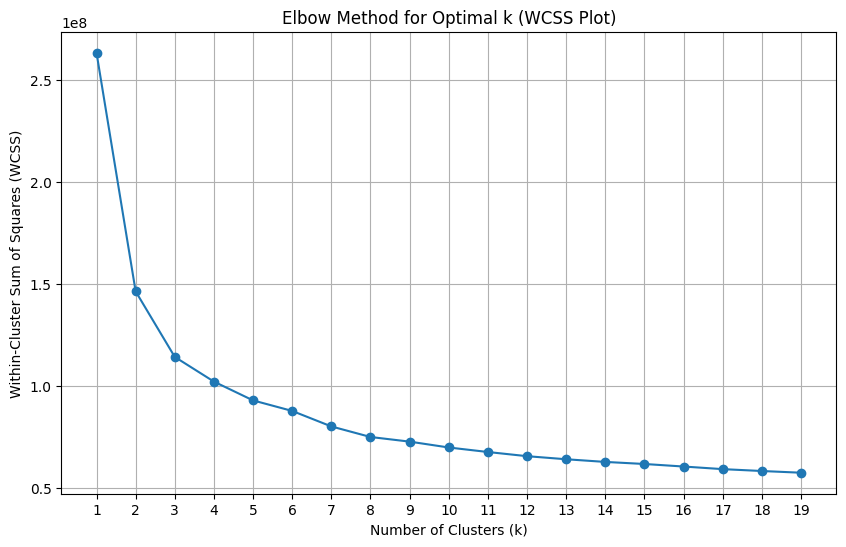


WCSS values for each k:
k=1: 263316160.0
k=2: 146431072.0
k=3: 114338384.0
k=4: 102256528.0
k=5: 93050656.0
k=6: 87890624.0
k=7: 80305728.0
k=8: 75137160.0
k=9: 72864488.0
k=10: 69992912.0
k=11: 67781696.0
k=12: 65738752.0
k=13: 64233392.0
k=14: 62926200.0
k=15: 61915600.0
k=16: 60671796.0
k=17: 59396628.0
k=18: 58478548.0
k=19: 57639624.0


In [7]:
# Initialize an empty list to store WCSS values
wcss = []
k_values = range(1, 20, 1) # Example: test k from 1 to 10
# Loop through each k value
for k in k_values:
    print(f"Processing k = {k}...")
    mb_kmeans = MiniBatchKMeans(n_clusters=k,
                                random_state=42,
                                batch_size=64 * k,
                                init='k-means++',
                                n_init=1,
                                init_size=100000,
                                reassignment_ratio=5e-4,
                                verbose=0) # Set verbose to 0 for cleaner output during loop

    mb_kmeans.fit(df)
    
    # The inertia_ attribute gives the WCSS for MiniBatchKMeans
    wcss.append(mb_kmeans.inertia_)
    
    # Optional: You can uncomment the lines below if you want to see predictions and centers for each k
    # predictions = mb_kmeans.labels_
    # cluster_centers = mb_kmeans.cluster_centers_
    # print(f"  WCSS for k={k}: {mb_kmeans.inertia_}")

# Plotting the WCSS values
plt.figure(figsize=(10, 6))
plt.plot(k_values, wcss, marker='o', linestyle='-')
plt.title('Elbow Method for Optimal k (WCSS Plot)')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Within-Cluster Sum of Squares (WCSS)')
plt.xticks(k_values)
plt.grid(True)
plt.show()

print("\nWCSS values for each k:")
for k, score in zip(k_values, wcss):
    print(f"k={k}: {score}")

In [8]:
k=4
mb_kmeans = MiniBatchKMeans(n_clusters=k,
                            random_state=42,
                            batch_size=64 * k,
                            init='k-means++', n_init=1, init_size=100000,
                            reassignment_ratio=5e-4,
                            verbose=0)

mb_kmeans.fit(df)
predictions = mb_kmeans.labels_
cluster_centers = mb_kmeans.cluster_centers_

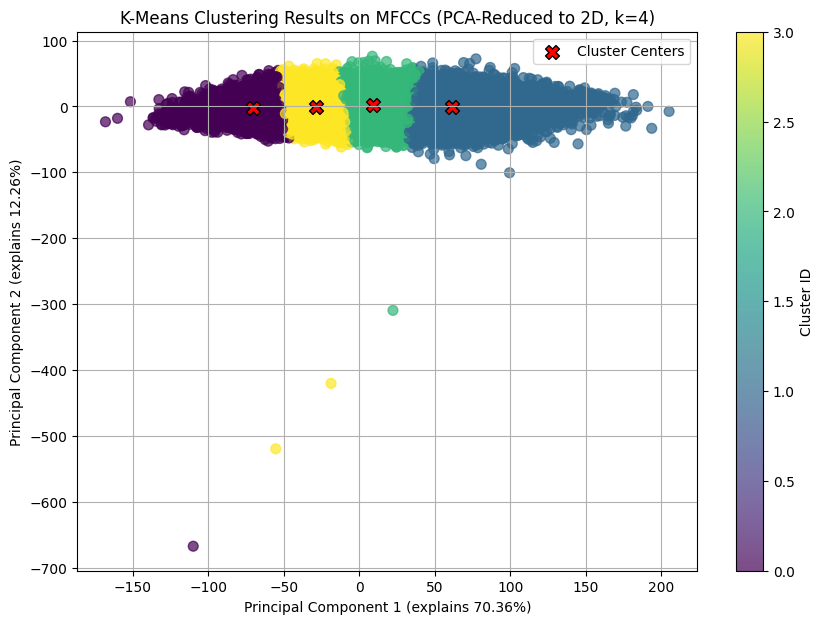

In [9]:
limit = 107303
pca_2d = PCA(n_components=2, random_state=42)
d_pca_2d = pca_2d.fit_transform(df[:limit])
cluster_centers_pca_2d = pca_2d.transform(cluster_centers)

plt.figure(figsize=(10, 7))
# Scatter plot of PCA-reduced data points, colored by their assigned cluster
scatter_2d = plt.scatter(d_pca_2d[:, 0], d_pca_2d[:, 1], c=predictions[:limit], cmap='viridis', s=50, alpha=0.7)
# Plot the PCA-reduced cluster centers
plt.scatter(cluster_centers_pca_2d[:, 0], cluster_centers_pca_2d[:, 1], marker='X', s=100, color='red',
            edgecolor='black', label='Cluster Centers')
plt.title(f'K-Means Clustering Results on MFCCs (PCA-Reduced to 2D, k={k})')
plt.xlabel(f'Principal Component 1 (explains {pca_2d.explained_variance_ratio_[0]*100:.2f}%)')
plt.ylabel(f'Principal Component 2 (explains {pca_2d.explained_variance_ratio_[1]*100:.2f}%)')
plt.colorbar(scatter_2d, label='Cluster ID')
plt.legend()
plt.grid(True)
# plt.show()

In [10]:
mel_clus = pd.DataFrame({
    "ID" : df.index,
    "cluster" : predictions,
})

In [11]:
mel_clus.head()

,ID,cluster
0,rugby_vsXaverian_050615_SLASH_rugby_vsXaverian...,3
1,gov_DOT_uscourts_DOT_ca5_DOT_18-30469_SLASH_go...,0
2,gov_DOT_uscourts_DOT_ca10_DOT_19-3108_SLASH_go...,1
3,gov_DOT_uscourts_DOT_ca9_DOT_02-50579_SLASH_go...,3
4,2001_Peters_Township_High_School_Commencement_...,2


In [12]:
main_df.head()


,ID,duration,wav,spk_id,sex,text
0,20091124-0900-PLENARY-18-en_20091124-22:35:55_9,17.120000,20091124-0900-PLENARY-18-en_20091124-22:35:55_...,1309,male,AND WHAT ABOUT INTEROPERABILITY IN THE RAIL SE...
1,20171024-0900-PLENARY-19-en_20171024-19:35:50_20,13.579937,20171024-0900-PLENARY-19-en_20171024-19:35:50_...,NaN,male,THIS WILL NOT HAPPEN THIS IS A PROMISE I MAKE ...
2,20150520-0900-PLENARY-8-en_20150520-13:27:12_5,9.797000,20150520-0900-PLENARY-8-en_20150520-13:27:12_5...,124985,male,IT IS GOOD TO SEE SOMETHING BEING DONE ABOUT I...
3,20170613-0900-PLENARY-9-en_20170613-13:02:00_0,16.377250,20170613-0900-PLENARY-9-en_20170613-13:02:00_0...,28115,female,MR PRESIDENT I WANT TO PUT ON THE RECORD MY SU...
4,20170911-0900-PLENARY-16-en_20170911-18:23:37_6,6.759938,20170911-0900-PLENARY-16-en_20170911-18:23:37_...,96897,male,POLITICAL CORRECTNESS IS THE CORNERSTONE OF TH...


In [14]:
fractions

[0.2, 0.4, 0.6, 0.8]

In [18]:
csv_location = "/local_disk/apollon/rwhetten/loquacious_small_train.csv"
save_location = "/local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_mel/loquacious_small_train"
main_df = pd.read_csv(csv_location)

for i in fractions:
    # Assume df is your DataFrame with a 'cluster' column
    X = int(len(main_df) * i)  # total samples you want
    clusters = mel_clus['cluster'].unique()
    n_clusters = len(clusters)
    samples_per_cluster = X // n_clusters
    remainder = X % n_clusters
    
    # Group the dataframe by 'cluster'
    grouped = mel_clus.groupby('cluster')
    
    # Sample equally from each cluster
    sampled_df = grouped.apply(lambda g: g.sample(n=min(len(g), samples_per_cluster), random_state=0)).reset_index(drop=True)
    
    # If there's a remainder (e.g., 1000 samples over 3 clusters → 333 per cluster + 1 extra),
    # randomly pick clusters to get 1 more sample from
    if remainder > 0:
        cluster_sizes = mel_clus['cluster'].value_counts()
        eligible_clusters = cluster_sizes[cluster_sizes > samples_per_cluster].index
        extra_clusters = np.random.choice(eligible_clusters, size=remainder, replace=False)
    
        extras = mel_clus[mel_clus['cluster'].isin(extra_clusters)].groupby('cluster').apply(
            lambda g: g.sample(n=1, random_state=0)
        ).reset_index(drop=True)
    
        sampled_df = pd.concat([sampled_df, extras], ignore_index=True)
        
    print(len(sampled_df))
    # filter with main df and then save
    filtered_main_df = main_df[main_df['ID'].isin(sampled_df['ID'])]
    print(f"{filtered_main_df.duration.sum()/ 3600} hours")
    save_name = f"{save_location}_{str(i)}_mel.csv"
    print(f"saving to {save_name}")
    filtered_main_df.to_csv(save_name, index=False)

/tmp/ipykernel_11958/1114159945.py:17: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



21460
49.703293792457956 hours
saving to /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_mel/loquacious_small_train_0.2_mel.csv


/tmp/ipykernel_11958/1114159945.py:17: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

/tmp/ipykernel_11958/1114159945.py:26: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



42921
99.14400005503592 hours
saving to /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_mel/loquacious_small_train_0.4_mel.csv


/tmp/ipykernel_11958/1114159945.py:17: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

/tmp/ipykernel_11958/1114159945.py:26: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



59552
137.98328716218663 hours
saving to /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_mel/loquacious_small_train_0.6_mel.csv


/tmp/ipykernel_11958/1114159945.py:17: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

/tmp/ipykernel_11958/1114159945.py:26: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



75110
174.55953673628824 hours
saving to /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_mel/loquacious_small_train_0.8_mel.csv


## LG

In [23]:
df = pd.DataFrame.from_dict(mel_lg['results']).T
df.head()

,0,1,2,3,4,5,6,7,8,9,...,29,30,31,32,33,34,35,36,37,38
snafuinfinityfootball_vsWOBURN_092118-CL19_SLASH_football_vsWOBURN_092118-CL19_DOT_mp3_00025.flac,-150.178024,20.112110,-11.501924,-1.449854,-15.125900,0.157504,-5.432830,-1.768510,-3.259856,-3.649934,...,-0.001829,0.001195,-0.011839,0.007008,0.006832,0.007198,-0.001744,-0.002431,-0.017000,-0.012432
Grad2009_SLASH_Grad2009_DOT_mp3_00006.flac,-179.132660,25.008080,2.044729,6.493776,-3.964765,-2.304045,1.511492,-2.448147,1.143050,0.940334,...,-0.008804,0.022103,0.023557,-0.013852,0.001505,0.003159,0.004628,-0.004877,-0.002304,-0.007152
texas_terror_1935_SLASH_texas_terror_1935_DOT_mp3_00002.flac,-181.057144,26.448055,-7.964648,2.730549,-0.780316,-0.657237,-0.104363,0.957595,-2.103266,-0.983917,...,0.039257,0.016973,-0.012449,0.004981,0.030585,0.010287,-0.021672,-0.019635,-0.012271,-0.001298
unfinished_task_SLASH_unfinished_task_DOT_mp3_00022.flac,-133.819336,42.418552,-22.415033,7.140134,1.418300,-9.882423,-9.354074,-4.318173,-3.120260,-1.788946,...,0.007597,-0.003642,0.006924,0.003304,-0.006618,-0.003144,0.000489,0.005005,-0.000316,0.000715
gov_DOT_uscourts_DOT_ca3_DOT_19-2975_SLASH_gov_DOT_uscourts_DOT_ca3_DOT_19-2975_DOT_2020-10-21_DOT_mp3_00006.flac,-175.453720,27.233545,-13.083720,8.682267,-9.429398,-9.109363,-6.361362,-16.926861,0.736825,0.722593,...,-0.004237,-0.033426,-0.016063,0.006987,-0.007664,0.006543,0.017294,0.017431,0.013511,0.006377


Processing k = 1...
Processing k = 2...
Processing k = 3...
Processing k = 4...
Processing k = 5...
Processing k = 6...
Processing k = 7...
Processing k = 8...
Processing k = 9...
Processing k = 10...
Processing k = 11...
Processing k = 12...
Processing k = 13...
Processing k = 14...
Processing k = 15...
Processing k = 16...
Processing k = 17...
Processing k = 18...
Processing k = 19...


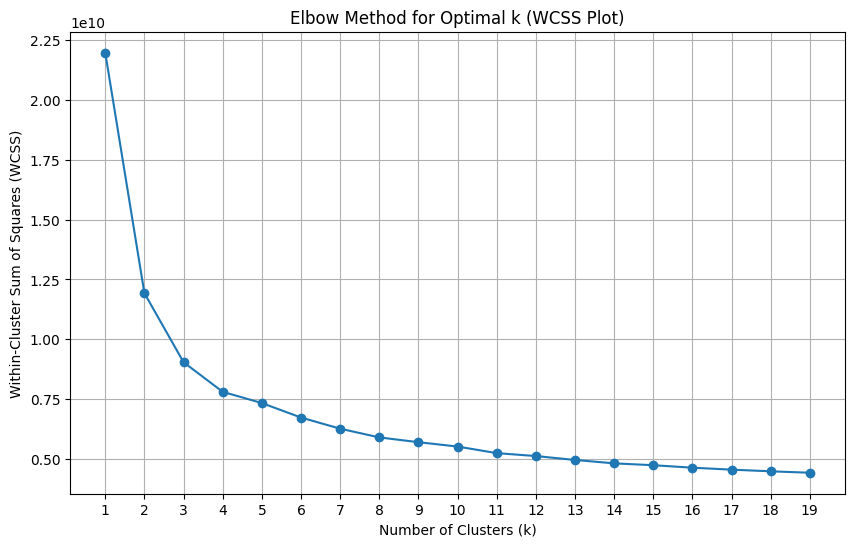


WCSS values for each k:
k=1: 21960067072.0
k=2: 11926680576.0
k=3: 9045379072.0
k=4: 7809442816.0
k=5: 7340285440.0
k=6: 6736534016.0
k=7: 6270742528.0
k=8: 5907053568.0
k=9: 5706498048.0
k=10: 5525475328.0
k=11: 5250940928.0
k=12: 5128557056.0
k=13: 4965635072.0
k=14: 4823612416.0
k=15: 4746083328.0
k=16: 4642832384.0
k=17: 4561138176.0
k=18: 4491819008.0
k=19: 4432823296.0


In [20]:
# Initialize an empty list to store WCSS values
wcss = []
k_values = range(1, 20, 1) # Example: test k from 1 to 10
# Loop through each k value
for k in k_values:
    print(f"Processing k = {k}...")
    mb_kmeans = MiniBatchKMeans(n_clusters=k,
                                random_state=42,
                                batch_size=64 * k,
                                init='k-means++',
                                n_init=1,
                                init_size=100000,
                                reassignment_ratio=5e-4,
                                verbose=0) # Set verbose to 0 for cleaner output during loop

    mb_kmeans.fit(df)
    
    # The inertia_ attribute gives the WCSS for MiniBatchKMeans
    wcss.append(mb_kmeans.inertia_)
    
    # Optional: You can uncomment the lines below if you want to see predictions and centers for each k
    # predictions = mb_kmeans.labels_
    # cluster_centers = mb_kmeans.cluster_centers_
    # print(f"  WCSS for k={k}: {mb_kmeans.inertia_}")

# Plotting the WCSS values
plt.figure(figsize=(10, 6))
plt.plot(k_values, wcss, marker='o', linestyle='-')
plt.title('Elbow Method for Optimal k (WCSS Plot)')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Within-Cluster Sum of Squares (WCSS)')
plt.xticks(k_values)
plt.grid(True)
plt.show()

print("\nWCSS values for each k:")
for k, score in zip(k_values, wcss):
    print(f"k={k}: {score}")

In [24]:
k=4
mb_kmeans = MiniBatchKMeans(n_clusters=k,
                            random_state=42,
                            batch_size=64 * k,
                            init='k-means++', n_init=1, init_size=100000,
                            reassignment_ratio=5e-4,
                            verbose=0)

mb_kmeans.fit(df)
predictions = mb_kmeans.labels_
cluster_centers = mb_kmeans.cluster_centers_

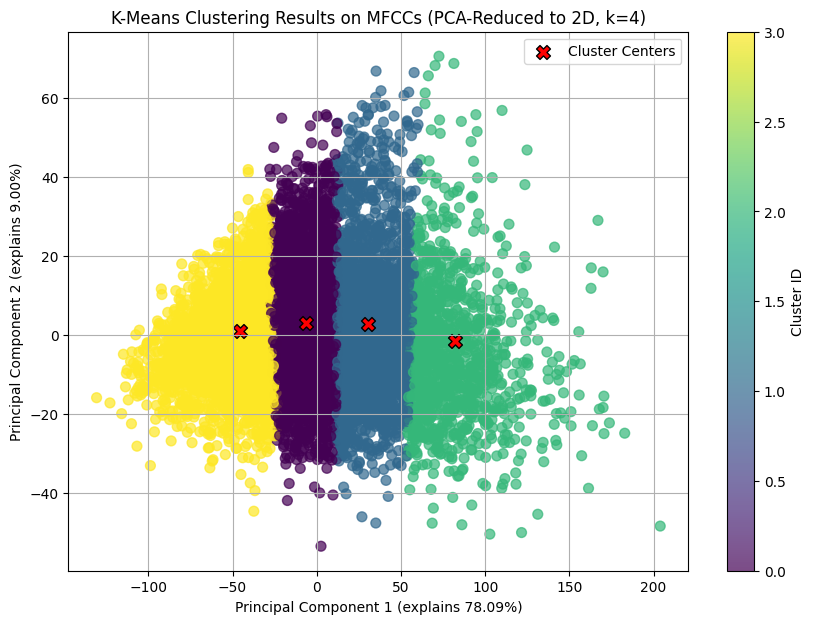

In [26]:
limit = 10000
pca_2d = PCA(n_components=2, random_state=42)
d_pca_2d = pca_2d.fit_transform(df[:limit])
cluster_centers_pca_2d = pca_2d.transform(cluster_centers)

plt.figure(figsize=(10, 7))
# Scatter plot of PCA-reduced data points, colored by their assigned cluster
scatter_2d = plt.scatter(d_pca_2d[:, 0], d_pca_2d[:, 1], c=predictions[:limit], cmap='viridis', s=50, alpha=0.7)
# Plot the PCA-reduced cluster centers
plt.scatter(cluster_centers_pca_2d[:, 0], cluster_centers_pca_2d[:, 1], marker='X', s=100, color='red',
            edgecolor='black', label='Cluster Centers')
plt.title(f'K-Means Clustering Results on MFCCs (PCA-Reduced to 2D, k={k})')
plt.xlabel(f'Principal Component 1 (explains {pca_2d.explained_variance_ratio_[0]*100:.2f}%)')
plt.ylabel(f'Principal Component 2 (explains {pca_2d.explained_variance_ratio_[1]*100:.2f}%)')
plt.colorbar(scatter_2d, label='Cluster ID')
plt.legend()
plt.grid(True)

In [27]:
mel_clus = pd.DataFrame({
    "ID" : df.index,
    "cluster" : predictions,
})

In [28]:
len(mel_clus)

9487873

In [29]:
csv_location = "/local_disk/apollon/rwhetten/loquacious_large_train.csv"
save_location = "/local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/large_mel/loquacious_large_train"
main_df = pd.read_csv(csv_location)

for i in fractions:
    # Assume df is your DataFrame with a 'cluster' column
    X = int(len(main_df) * i)  # total samples you want
    clusters = mel_clus['cluster'].unique()
    n_clusters = len(clusters)
    samples_per_cluster = X // n_clusters
    remainder = X % n_clusters
    
    # Group the dataframe by 'cluster'
    grouped = mel_clus.groupby('cluster')
    
    # Sample equally from each cluster
    sampled_df = grouped.apply(lambda g: g.sample(n=min(len(g), samples_per_cluster), random_state=42)).reset_index(drop=True)
    
    # If there's a remainder (e.g., 1000 samples over 3 clusters → 333 per cluster + 1 extra),
    # randomly pick clusters to get 1 more sample from
    if remainder > 0:
        cluster_sizes = mel_clus['cluster'].value_counts()
        eligible_clusters = cluster_sizes[cluster_sizes > samples_per_cluster].index
        extra_clusters = np.random.choice(eligible_clusters, size=remainder, replace=False)
    
        extras = mel_clus[mel_clus['cluster'].isin(extra_clusters)].groupby('cluster').apply(
            lambda g: g.sample(n=1, random_state=42)
        ).reset_index(drop=True)
    
        sampled_df = pd.concat([sampled_df, extras], ignore_index=True)
    print(len(sampled_df))
    # filter with main df and then save
    filtered_main_df = main_df[main_df['ID'].isin(sampled_df['ID'])]
    print(f"{filtered_main_df.duration.sum()/ 3600} hours")
    save_name = f"{save_location}_{str(fraction)}_mel.csv"
    filtered_main_df.to_csv(save_name, index=False)

/tmp/ipykernel_11958/2997205888.py:3: DtypeWarning:

Columns (3,4) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/ipykernel_11958/2997205888.py:17: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

/tmp/ipykernel_11958/2997205888.py:26: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



1897575
4929.958189670869 hours


/tmp/ipykernel_11958/2997205888.py:17: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

/tmp/ipykernel_11958/2997205888.py:26: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



3795150
9853.90240092684 hours


/tmp/ipykernel_11958/2997205888.py:17: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

/tmp/ipykernel_11958/2997205888.py:26: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



5492453
14326.795207875193 hours


/tmp/ipykernel_11958/2997205888.py:17: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

/tmp/ipykernel_11958/2997205888.py:26: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



6741925
17691.862274457595 hours


In [30]:
sampled_df.groupby('cluster').count()

,ID
cluster,
0,1897576
1,1897575
2,1222908
3,1723866


In [132]:
def sample_based_on_cluster(csv_loc, save_loc, fracts, cluster_df, name_ending="mel", random_state=0):
    # csv_loc = "/local_disk/apollon/rwhetten/loquacious_small_train.csv"
    # save_loc = "/local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_mel/loquacious_small_train"
    main_df = pd.read_csv(csv_loc)
    hours = []
    for i in fractions:
        # Assume df is your DataFrame with a 'cluster' column
        X = int(len(main_df) * i)  # total samples you want
        clusters = cluster_df['cluster'].unique()
        n_clusters = len(clusters)
        samples_per_cluster = X // n_clusters
        remainder = X % n_clusters

        print(samples_per_cluster)
        # Group the dataframe by 'cluster'
        grouped = cluster_df.groupby('cluster')
        
        # Sample equally from each cluster
        sampled_df = grouped.apply(lambda g: g.sample(n=min(len(g), samples_per_cluster), random_state=random_state)).reset_index(drop=True)
        
        # If there's a remainder (e.g., 1000 samples over 3 clusters → 333 per cluster + 1 extra),
        # randomly pick clusters to get 1 more sample from
        if remainder > 0:
            cluster_sizes = cluster_df['cluster'].value_counts()
            eligible_clusters = cluster_sizes[cluster_sizes > samples_per_cluster].index
            extra_clusters = np.random.choice(eligible_clusters, size=min(len(eligible_clusters), remainder), replace=False)
        
            extras = cluster_df[cluster_df['cluster'].isin(extra_clusters)].groupby('cluster').apply(
                lambda g: g.sample(n=1, random_state=random_state)
            ).reset_index(drop=True)
        
            sampled_df = pd.concat([sampled_df, extras], ignore_index=True)
            
        print(len(sampled_df))
        # filter with main df and then save
        filtered_main_df = main_df[main_df['ID'].isin(sampled_df['ID'])]
        hours.append(filtered_main_df.duration.sum()/ 3600)
        print(f"{filtered_main_df.duration.sum()/ 3600} hours")
        save_name = f"{save_loc}_{str(i)}_{name_ending}.csv"
        print(f"saving to {save_name}")
        filtered_main_df.to_csv(save_name, index=False)
    return hours

In [4]:
df_speaker = pd.DataFrame.from_dict(speaker['results']).T
df_speaker.head()

,0,1,2,3,4,5,6,7,8,9,...,246,247,248,249,250,251,252,253,254,255
common_voice_en_24146008,-0.224990,-0.064609,-0.501496,-0.321037,0.166265,0.207059,-0.071313,0.125329,-0.146821,0.020395,...,0.381471,0.057810,-0.218501,-0.182242,0.276759,0.215276,0.227152,-0.157252,0.255455,0.196293
common_voice_en_19283701,0.080336,0.021248,0.012901,-0.319770,0.142971,0.058614,-0.327455,-0.080786,-0.035303,-0.092950,...,-0.171805,0.145816,0.110169,-0.032337,0.277806,-0.140520,0.063454,-0.039363,-0.052334,-0.296683
common_voice_en_29851180,-0.127730,-0.064158,0.138645,-0.459717,0.043553,0.046773,-0.106986,0.088134,0.155397,0.218202,...,0.318263,-0.023648,0.009230,-0.311788,0.222778,0.235446,0.023832,-0.011030,-0.005480,0.096868
common_voice_en_31934744,-0.027230,0.045542,-0.033144,0.042867,0.032638,0.104369,0.256894,0.031085,0.118302,0.013488,...,-0.166254,-0.024266,-0.066041,0.103622,-0.066448,0.059844,-0.054693,-0.055785,0.096407,0.015177
common_voice_en_36303288,-0.106699,0.170953,-0.000962,0.056935,0.137603,0.025845,0.152257,-0.069499,0.179031,0.017337,...,-0.158327,-0.019315,0.105360,-0.152181,-0.061221,-0.029839,-0.120326,0.003563,0.264232,0.074354


In [12]:
# # Initialize an empty list to store WCSS values
# wcss = []
# k_values = range(1, 1001, 500) # Example: test k from 1 to 10
# # Loop through each k value
# for k in k_values:
#     print(f"Processing k = {k}...")
#     mb_kmeans = MiniBatchKMeans(n_clusters=k,
#                                 random_state=42,
#                                 batch_size=64 * k,
#                                 init='k-means++',
#                                 n_init=1,
#                                 init_size=100000,
#                                 reassignment_ratio=5e-4,
#                                 verbose=0) # Set verbose to 0 for cleaner output during loop

#     mb_kmeans.fit(df_speaker)
    
#     # The inertia_ attribute gives the WCSS for MiniBatchKMeans
#     wcss.append(mb_kmeans.inertia_)
    
#     # Optional: You can uncomment the lines below if you want to see predictions and centers for each k
#     # predictions = mb_kmeans.labels_
#     # cluster_centers = mb_kmeans.cluster_centers_
#     # print(f"  WCSS for k={k}: {mb_kmeans.inertia_}")

# # Plotting the WCSS values
# plt.figure(figsize=(10, 6))
# plt.plot(k_values, wcss, marker='o', linestyle='-')
# plt.title('Elbow Method for Optimal k (WCSS Plot)')
# plt.xlabel('Number of Clusters (k)')
# plt.ylabel('Within-Cluster Sum of Squares (WCSS)')
# plt.xticks(k_values)
# plt.grid(True)
# plt.show()

# print("\nWCSS values for each k:")
# for k, score in zip(k_values, wcss):
#     print(f"k={k}: {score}")

In [68]:
k=100
mb_kmeans = MiniBatchKMeans(n_clusters=k,
                            random_state=42,
                            batch_size=64 * k,
                            init='k-means++', n_init=1, init_size=100000,
                            reassignment_ratio=5e-4,
                            verbose=0)

mb_kmeans.fit(df_speaker)
predictions = mb_kmeans.labels_
cluster_centers = mb_kmeans.cluster_centers_

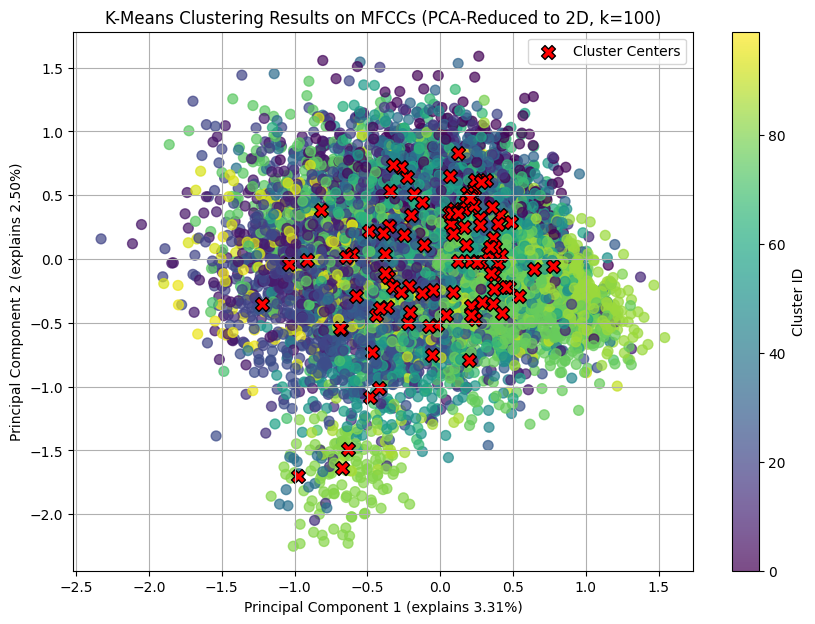

In [69]:
limit = 10700
pca_2d = PCA(n_components=2, random_state=42)
d_pca_2d = pca_2d.fit_transform(df_speaker[:limit])
cluster_centers_pca_2d = pca_2d.transform(cluster_centers)

plt.figure(figsize=(10, 7))
# Scatter plot of PCA-reduced data points, colored by their assigned cluster
scatter_2d = plt.scatter(d_pca_2d[:, 0], d_pca_2d[:, 1], c=predictions[:limit], cmap='viridis', s=50, alpha=0.7)
# Plot the PCA-reduced cluster centers
plt.scatter(cluster_centers_pca_2d[:, 0], cluster_centers_pca_2d[:, 1], marker='X', s=100, color='red',
            edgecolor='black', label='Cluster Centers')
plt.title(f'K-Means Clustering Results on MFCCs (PCA-Reduced to 2D, k={k})')
plt.xlabel(f'Principal Component 1 (explains {pca_2d.explained_variance_ratio_[0]*100:.2f}%)')
plt.ylabel(f'Principal Component 2 (explains {pca_2d.explained_variance_ratio_[1]*100:.2f}%)')
plt.colorbar(scatter_2d, label='Cluster ID')
plt.legend()
plt.grid(True)

In [70]:
speaker_clus = pd.DataFrame({
    "ID" : df_speaker.index,
    "cluster" : predictions,
})

In [104]:

csv_location = "/local_disk/apollon/rwhetten/loquacious_small_train.csv"
save_location = "/local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_speaker/loquacious_small_train"
main_df = pd.read_csv(csv_location)

hours = sample_based_on_cluster(csv_location, save_location, fractions, speaker_clus, "speaker", 42)

/tmp/ipykernel_19420/3327689845.py:18: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

/tmp/ipykernel_19420/3327689845.py:27: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



20011
49.737302211238664 hours
saving to /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_speaker/loquacious_small_train_0.2_speaker.csv


/tmp/ipykernel_19420/3327689845.py:18: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

/tmp/ipykernel_19420/3327689845.py:27: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



35094
86.00203962831081 hours
saving to /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_speaker/loquacious_small_train_0.4_speaker.csv


/tmp/ipykernel_19420/3327689845.py:18: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

/tmp/ipykernel_19420/3327689845.py:27: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



47994
116.38104588870387 hours
saving to /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_speaker/loquacious_small_train_0.6_speaker.csv


/tmp/ipykernel_19420/3327689845.py:18: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

/tmp/ipykernel_19420/3327689845.py:27: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



59629
143.20565618301603 hours
saving to /local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_speaker/loquacious_small_train_0.8_speaker.csv


In [97]:
test = pd.read_csv("/local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/small_speaker/loquacious_small_train_0.8_speaker.csv")
test[test.ID.duplicated()]

,ID,duration,wav,spk_id,sex,text


In [22]:
speaker_clus.to_csv("/local_disk/apollon/rwhetten/sss_data_selection/sample/csvs/loquacious_small_train_speaker_clusters.csv", index=False)

,ID,cluster
34,gov_DOT_uscourts_DOT_ca9_DOT_20-15447_SLASH_go...,1
2441,w8hvxrjh49M-00122-00043700-00044000.wav,1
2652,Wu3zL5ae9Ec-00509-00253356-00253673.wav,1
2660,XJ24tbhVfx0-00387-00137356-00137660.wav,1
2755,tPNj0Cd3Umg-00470-00174103-00174418.wav,1


<Axes: >

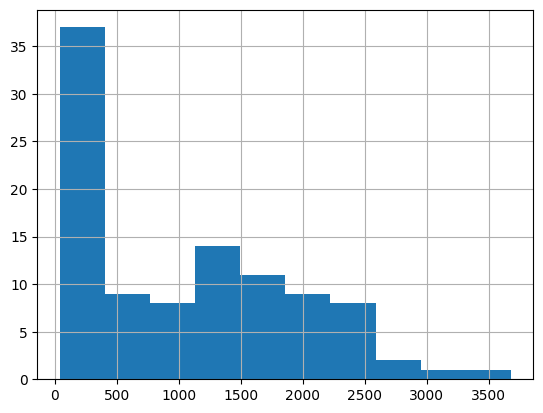

In [71]:
# speaker_clus.groupby('cluster').sum()
speaker_clus.cluster.value_counts().hist()

In [72]:
pd.DataFrame(speaker_clus.cluster.value_counts())

,count
cluster,
77,3677
63,3067
58,2788
52,2643
71,2531
...,...
86,99
97,77
62,73


In [73]:
speaker_clus[speaker_clus.cluster == 11].head()

,ID,cluster
715,20181024-0900-PLENARY-en_20181024-21:48:46_4,11
722,20170301-0900-PLENARY-12-en_20170301-18:17:45_8,11
723,20091124-0900-PLENARY-14-en_20091124-20:08:34_2,11
742,20180531-0900-PLENARY-2-en_20180531-09:01:13_9,11
769,20200917-0900-PLENARY-en_20200917-11:06:57_21,11


In [75]:
from IPython.display import Audio, display
samplerate=16000

for i, r in speaker_clus[speaker_clus.cluster == 12].head().iterrows():
    print(r.ID)
    sig = read_audio(f"/local_disk/apollon/rwhetten/wavs/small/train/{r.ID}.wav")
    display(Audio(sig, rate=samplerate))

20120417-0900-PLENARY-11-en_20120417-20:23:15_41


20091111-0900-PLENARY-21-en_20091112-00:07:51_42


20100119-0900-PLENARY-5-en_20100119-16:24:24_31


20111213-0900-PLENARY-12-en_20111213-18:16:00_13


20120417-0900-PLENARY-11-en_20120417-20:23:15_37


In [13]:
# Fit KMeans
mb_kmeans = MiniBatchKMeans(
    n_clusters=k,
    random_state=42,
    batch_size=64 * k,
    init='k-means++',
    n_init=1,
    init_size=100000,
    reassignment_ratio=5e-4,
    verbose=0
)
mb_kmeans.fit(df)
predictions = mb_kmeans.labels_
cluster_centers = mb_kmeans.cluster_centers_


In [14]:
# PCA
limit = 107303
pca_2d = PCA(n_components=2, random_state=42)
d_pca_2d = pca_2d.fit_transform(df[:limit])
cluster_centers_pca_2d = pca_2d.transform(cluster_centers)

In [15]:
# Build hover info with index
hover_text = [f"Index: {i}" for i in range(limit)]

# Create scatter plot
fig = go.Figure()

# Add data points
fig.add_trace(go.Scatter(
    x=d_pca_2d[:, 0],
    y=d_pca_2d[:, 1],
    mode='markers',
    marker=dict(
        size=6,
        color=predictions,
        colorscale='Viridis',
        opacity=0.7,
        colorbar=dict(title='Cluster ID')
    ),
    text=hover_text,
    hoverinfo='text',
    name='Data Points'
))

# Add cluster centers
fig.add_trace(go.Scatter(
    x=cluster_centers_pca_2d[:, 0],
    y=cluster_centers_pca_2d[:, 1],
    mode='markers',
    marker=dict(
        size=14,
        symbol='x',
        color='red',
        line=dict(width=2, color='black')
    ),
    name='Cluster Centers'
))

# Layout
fig.update_layout(
    title=f'K-Means Clustering Results on MFCCs (PCA-Reduced to 2D, k={k})',
    xaxis_title=f'Principal Component 1 ({pca_2d.explained_variance_ratio_[0]*100:.2f}%)',
    yaxis_title=f'Principal Component 2 ({pca_2d.explained_variance_ratio_[1]*100:.2f}%)',
    legend=dict(title='Legend'),
    width=900,
    height=700
)

fig.show()

### load file from dataset

In [16]:
# load dataset
hf_data_dict = load_datasets(
    "small",
    "speechbrain/LoquaciousSet",
    "/local_disk/apollon/rwhetten/hf_root/datasets",
)

Resolving data files:   0%|          | 0/6323 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/72 [00:00<?, ?it/s]

Loading dataset shards:   0%|          | 0/66 [00:00<?, ?it/s]

In [17]:
# Build an ID-to-item index
# id_to_item = {item["ID"]: item for item in hf_data_dict["train"]}
id_to_item = {}
for i, item in enumerate(tqdm(hf_data_dict["train"])):
    id_to_item[item["ID"]] = item
    

  0%|          | 0/107303 [00:00<?, ?it/s]

In [25]:
loi = [101818, 107241, 32668, 107302, 105666, 105406, 102414]

In [26]:
from IPython.display import Audio, display
samplerate=16000
for i in loi:
    fn = df.iloc[i].name
    f = id_to_item.get(fn)
    sig = read_audio(f["wav"]["bytes"])
    display(Audio(sig, rate=samplerate))


In [27]:
df_speaker = pd.DataFrame.from_dict(speaker_lg['results']).T
df_speaker.head()

,0,1,2,3,4,5,6,7,8,9,...,246,247,248,249,250,251,252,253,254,255
snafuinfinityfootball_vsWOBURN_092118-CL19_SLASH_football_vsWOBURN_092118-CL19_DOT_mp3_00025.flac,-0.046254,-0.064087,-0.096097,-0.107513,-0.050994,-0.032374,0.249068,-0.219559,0.045343,0.027503,...,-0.205633,-0.043007,-0.100376,-0.094326,-0.042314,-0.124987,0.033182,0.244299,0.234942,0.045202
Grad2009_SLASH_Grad2009_DOT_mp3_00006.flac,0.092818,-0.343982,-0.237657,-0.384233,0.456225,-0.012949,0.179669,-0.305312,0.140377,-0.175030,...,0.054900,0.007778,0.040266,0.204871,0.114417,-0.367068,-0.240021,0.098663,0.197409,-0.117200
texas_terror_1935_SLASH_texas_terror_1935_DOT_mp3_00002.flac,-0.054206,-0.088970,-0.124893,-0.014069,-0.140625,0.161785,0.026947,-0.030485,0.082166,-0.058114,...,-0.150152,0.055224,0.112032,0.084941,0.036592,-0.088939,-0.032801,0.174502,0.311173,-0.001009
unfinished_task_SLASH_unfinished_task_DOT_mp3_00022.flac,0.055183,-0.191430,-0.021690,-0.285761,0.225623,-0.086730,0.106433,-0.339067,0.055312,0.150259,...,-0.038836,0.299592,0.099919,0.070111,-0.025070,-0.167474,-0.147892,0.332172,0.108491,-0.081120
gov_DOT_uscourts_DOT_ca3_DOT_19-2975_SLASH_gov_DOT_uscourts_DOT_ca3_DOT_19-2975_DOT_2020-10-21_DOT_mp3_00006.flac,-0.241946,-0.115047,-0.134957,-0.243144,0.081856,-0.002123,0.079598,0.109838,-0.040556,0.000471,...,0.121072,-0.130224,0.012651,-0.470264,-0.252125,-0.141382,0.125283,0.044098,0.149792,-0.065720


In [33]:
len(df_speaker) == len(df)

True

In [29]:
# with open('speaker_lg.npy', 'wb') as f:
#     np.save(f, np.array(df_speaker))

In [41]:
k=100
mb_kmeans = MiniBatchKMeans(n_clusters=k,
                            random_state=42,
                            batch_size=64 * k,
                            init='k-means++', n_init=1, init_size=100000,
                            reassignment_ratio=5e-4,
                            verbose=2)

mb_kmeans.fit(df_speaker)
predictions = mb_kmeans.labels_
cluster_centers = mb_kmeans.cluster_centers_

Init 1/1 with method k-means++
Inertia for init 1/1: 1168212.375
Minibatch step 1/148248: mean batch inertia: 11.74656005859375
Minibatch step 2/148248: mean batch inertia: 9.169507446289062, ewa inertia: 9.169507446289062
Minibatch step 3/148248: mean batch inertia: 8.937924194335938, ewa inertia: 9.169195019540457
Minibatch step 4/148248: mean batch inertia: 8.830819091796876, ewa inertia: 9.168738519815111
Minibatch step 5/148248: mean batch inertia: 8.780599365234375, ewa inertia: 9.168214884996749
Minibatch step 6/148248: mean batch inertia: 8.750467529296875, ewa inertia: 9.167651306037653
Minibatch step 7/148248: mean batch inertia: 8.723016357421875, ewa inertia: 9.16705145328431
Minibatch step 8/148248: mean batch inertia: 8.783201904296876, ewa inertia: 9.166533605531797
Minibatch step 9/148248: mean batch inertia: 8.763055419921875, ewa inertia: 9.165989276973491
Minibatch step 10/148248: mean batch inertia: 8.670405883789062, ewa inertia: 9.165320690161234
Minibatch step 11

In [50]:
limit = 10000

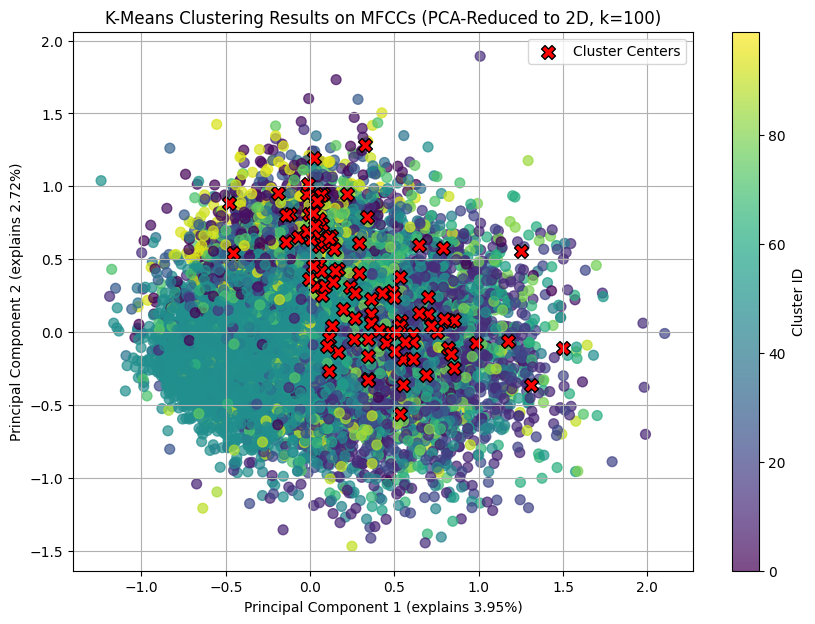

In [51]:
pca_2d = PCA(n_components=2, random_state=42)
d_pca_2d = pca_2d.fit_transform(df_speaker[:limit])
cluster_centers_pca_2d = pca_2d.transform(cluster_centers)

plt.figure(figsize=(10, 7))
# Scatter plot of PCA-reduced data points, colored by their assigned cluster
scatter_2d = plt.scatter(d_pca_2d[:, 0], d_pca_2d[:, 1], c=predictions[:limit], cmap='viridis', s=50, alpha=0.7)
# Plot the PCA-reduced cluster centers
plt.scatter(cluster_centers_pca_2d[:, 0], cluster_centers_pca_2d[:, 1], marker='X', s=100, color='red',
            edgecolor='black', label='Cluster Centers')
plt.title(f'K-Means Clustering Results on MFCCs (PCA-Reduced to 2D, k={k})')
plt.xlabel(f'Principal Component 1 (explains {pca_2d.explained_variance_ratio_[0]*100:.2f}%)')
plt.ylabel(f'Principal Component 2 (explains {pca_2d.explained_variance_ratio_[1]*100:.2f}%)')
plt.colorbar(scatter_2d, label='Cluster ID')
plt.legend()
plt.grid(True)
plt.show()
# plt.savefig('speaker_lg_kmeans_100_pca_2.svg')